# This notebook validates trained BuDDI4 models on whether the sample id latent space informs decoding and is sufficiently disentangled from the other latent spaces, for the bulk RNA-seq data

In [1]:
import json
import os
import joblib
import sys
import pathlib
import yaml
import subprocess

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, calinski_harabasz_score


2025-05-20 15:20:18.168193: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-20 15:20:18.178309: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747776018.188648 3180940 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747776018.191767 3180940 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1747776018.200819 3180940 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [2]:
CELL_TYPE_COL = 'encode_celltype'
SAMPLE_ID_COL = 'sample_id'
STIM_COL = 'stim'
TECH_COL = 'samp_type'
DATASPLIT_COL = 'isTraining'

GENE_ID_COL = 'gene_ids'

In [3]:
# Get the root directory of the analysis repository
REPO_ROOT = subprocess.run(
    ["git", "rev-parse", "--show-toplevel"], capture_output=True, text=True
).stdout.strip()
REPO_ROOT = pathlib.Path(REPO_ROOT)

CONFIG_FILE = REPO_ROOT / 'config.yml'
assert CONFIG_FILE.exists(), f"Config file not found at {CONFIG_FILE}"

with open(CONFIG_FILE, 'r') as file:
    config_dict = yaml.safe_load(file)

### Get HGSC subtype calls and format

In [4]:
data_path = pathlib.Path(config_dict['data_path']['bulk_data_path'])

bulk_metadata_files = [
    'supp_table_3_main_black_metadata_table.tsv',
    'supp_table_4_main_white_metadata_table.tsv'
]

bulk_metadata_df = pd.DataFrame()
for file in bulk_metadata_files:
    file_path = data_path / file
    if file_path.exists():
        temp_df = pd.read_csv(file_path, sep='\t')
        if 'white' in str(file):
            temp_df['race'] = 'white'
        elif 'black' in str(file): 
            temp_df['race'] = 'black'
        else:
            temp_df['race'] = 'unknown'
        
        bulk_metadata_df = pd.concat([bulk_metadata_df, temp_df], ignore_index=True)
    else:
        print(f"File not found: {file_path}")

bulk_metadata_df = bulk_metadata_df.drop_duplicates(subset='ID')
bulk_metadata_df[SAMPLE_ID_COL] = bulk_metadata_df['ID']
bulk_metadata_df.set_index('ID', inplace=True)
bulk_metadata_df.head()

,ran_in_way_pipeline,ClusterK2_kmeans,ClusterK3_kmeans,ClusterK4_kmeans,ClusterK2_NMF,ClusterK3_NMF,ClusterK4_NMF,ClusterK4_kmeans_TCGA_names,external_HGSCsubtype_estimate,failed_seq,...,low_qual,version,REMOVE_WHITE,REMOVE_NEOADJ,REMOVE_LOW_EXPRESSION,study,Sample_ID,race,REMOVE_BLACK,sample_id
ID,,,,,,,,,,,,,,,,,,,,,
19291X1,True,1.0,1.0,1.0,1.0,1.0,1.0,Mesenchymal,NaN,NaN,...,NaN,full_run,NaN,NaN,NaN,AA,NCO0003,black,NaN,19291X1
19291X2,True,1.0,1.0,1.0,1.0,1.0,1.0,Mesenchymal,NaN,NaN,...,NaN,full_run,NaN,NaN,NaN,AA,NCO0028,black,NaN,19291X2
18341X1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C4.DIF,NaN,...,NaN,pilot,True,NaN,NaN,AA,NCO0051,black,NaN,18341X1
19291X3,True,2.0,2.0,2.0,1.0,2.0,2.0,Proliferative,NaN,NaN,...,NaN,full_run,NaN,NaN,NaN,AA,NCO0076,black,NaN,19291X3
19291X4,True,1.0,1.0,1.0,1.0,2.0,2.0,Mesenchymal,NaN,NaN,...,NaN,full_run,NaN,NaN,NaN,AA,NCO0080,black,NaN,19291X4


In [5]:
#  rename external HGSC subtype columns
subtype_mapping = {
    'C4.DIF': 'Differentiated',
    'C2.IMM': 'Immunoreactive',
    'C1.MES': 'Mesenchymal',
    'C5.PRO': 'Proliferative'
}

bulk_metadata_df['subtype_label'] = bulk_metadata_df['external_HGSCsubtype_estimate'].map(
    subtype_mapping)

# combine with internal calls
mask = bulk_metadata_df['ClusterK4_kmeans_TCGA_names'].notna()
bulk_metadata_df.loc[mask, 'subtype_label'] = bulk_metadata_df.loc[mask, 'ClusterK4_kmeans_TCGA_names']

# metadata for origin of subtype label
bulk_metadata_df['subtype_label_source'] = 'internal'
bulk_metadata_df.loc[mask, 'subtype_label_source'] = 'external'

In [6]:
pd.crosstab(bulk_metadata_df['race'], bulk_metadata_df['subtype_label'])

subtype_label,Differentiated,Immunoreactive,Mesenchymal,Proliferative
race,,,,
black,27,107,86,66
white,77,76,98,35


## Subsampling Bulk Data

### For the sake of simplicity, only perform and visalize imputation among a single race category. The subsampling (n) of around 100 helps keep memory usage in check and is necessary unless you have a super large RAM (of >=256GB).

In [7]:
select_race = 'black'
n = 100
stratified_sample = False

df_filter_race = bulk_metadata_df[bulk_metadata_df['race']=='black'].reset_index(drop=True)
df_filter_race = (
    df_filter_race[df_filter_race['subtype_label'].notna()].reset_index(drop=True)
)

### Helper function for balanced sampling

In [8]:
import pandas as pd

def balanced_sample(df, label_col, n, random_state=None):
    """
    Draw n samples from df, balanced across the unique values of label_col.
    If n isn’t divisible by the number of classes, the “extra” samples are
    distributed one‐by‐one to the first few classes in sorted order.
    
    Parameters
    ----------
    df : pd.DataFrame
    label_col : str
        Column name to balance on (must not contain NaNs).
    n : int
        Total number of samples to draw.
    random_state : int, optional
        Seed for reproducibility.
    
    Returns
    -------
    pd.DataFrame
        A shuffled DataFrame of length n, balanced across label_col.
    """
    df = df.copy()
    # identify the classes
    classes = sorted(df[label_col].unique())
    k = len(classes)
    if k == 0:
        raise ValueError("No classes found in label_col")
    
    # base count and remainder
    base = n // k
    rem  = n % k
    
    # determine exactly how many to sample per class
    counts = {
        cls: base + (1 if i < rem else 0)
        for i, cls in enumerate(classes)
    }
    
    # sample each class separately
    parts = []
    for cls, cnt in counts.items():
        cls_df = df[df[label_col] == cls]
        if len(cls_df) < cnt:
            raise ValueError(
                f"Not enough samples in class {cls!r} to draw {cnt} (only {len(cls_df)} available)"
            )
        parts.append(
            cls_df.sample(n=cnt, random_state=random_state)
        )
    
    # concatenate and reshuffle
    return pd.concat(parts).sample(frac=1, random_state=random_state).reset_index(drop=True)

In [9]:
if stratified_sample:

    sss = StratifiedShuffleSplit(n_splits=1, train_size=n, random_state=42)

    # Stratify by subtype_label
    train_idx, _ = next(sss.split(df_filter_race, df_filter_race['subtype_label']))
    sampled_df = df_filter_race.loc[train_idx]

else:

    sampled_df = balanced_sample(df_filter_race, 'subtype_label', n=n, random_state=42)


selected_sample_ids = sampled_df['sample_id'].tolist()
pd.crosstab(sampled_df['race'], sampled_df['subtype_label'])

subtype_label,Differentiated,Immunoreactive,Mesenchymal,Proliferative
race,,,,
black,25,25,25,25


## Software

In [10]:
buddi_fork_path = config_dict['software_path']['buddi_v2']
buddi_fork_path = pathlib.Path(buddi_fork_path)
assert buddi_fork_path.exists(), f"buddi fork not found at {buddi_fork_path}"

sys.path.append(str(REPO_ROOT))
sys.path.append(str(buddi_fork_path))
# this is quite ugly, once activate modifications are done this will be changed
# to a proper installation + import
from buddi_v2.models.buddi4_class import BuDDI4

In [11]:
from analysis_utils.inference.inference import _impute_sc_expression
from analysis_utils.plot_reconstruction import plot_reconstruction

## Define paths to Input Files/Output

### Input from pre-processing

In [12]:
PREPROCESSING_OUTPUT_PATH = REPO_ROOT / 'processed_data' 
buddi4_data_file = PREPROCESSING_OUTPUT_PATH / 'buddi4_data.pkl'
assert buddi4_data_file.exists(), f"Train data file not found at {buddi4_data_file}"

### Trained model save path

In [13]:
TRAINED_MODELS_PATH = REPO_ROOT / 'trained'
model_folders = sorted(TRAINED_MODELS_PATH.glob('buddi4_*'))
assert len(model_folders) > 0, f"No trained models found in {TRAINED_MODELS_PATH}"

In [14]:
buddi4_data = joblib.load(buddi4_data_file)
print(buddi4_data)
print('\n')

n_x = len(buddi4_data.gene_names)
n_y = len(buddi4_data.cell_type_names)
n_labels = buddi4_data.encode_meta[SAMPLE_ID_COL].shape[1]
n_stims = buddi4_data.encode_meta[STIM_COL].shape[1]
n_samp_types = buddi4_data.encode_meta[TECH_COL].shape[1]
print(f"Number of genes: {n_x}")
print(f"Number of cell types: {n_y}: ")
for ct in buddi4_data.cell_type_names:
    print(f"\t{ct}")
print(f"Number of unique labels: {n_labels}")
print(f"Number of unique stimulations: {n_stims}")
print(f"Number of unique sample types: {n_samp_types}")

BuDDI4Data(total_samples=8988, genes=7000, cell_types=11)


Number of genes: 7000
Number of cell types: 11: 
	Adipocytes
	B-cells
	CD4+ T-cells
	CD8+ T-cells
	Endothelial cells
	Epithelial cells
	Fibroblasts
	Macrophages
	Mesangial cells
	Monocytes
	NK cells
Number of unique labels: 593
Number of unique stimulations: 2
Number of unique sample types: 2


### Helper function to perform imputation on a saved model direcotry and save visualization figures

In [ ]:
import gc

def process_model_folder(
        model_folder: pathlib.Path,
        query_kwargs: dict,
        n_samples=None,
        select_ct = ['Epithelial cells'],
        ct_prop_to_plot = [],
        name_prefix = 'impute_'
    ):
    """
    Process a model folder, load the model, and plot UMAPs for each cell type.

    :param model_folder: Path to the model folder.
    :param query_kwargs: Query arguments passed to the data filteration step
    :param n_samples: Number of samples to query. Default is None using all samples.
    :param select_ct: Selected cell types to impute single-cell resolution expression
        and plot UMAPs for. Default is ['Epithelial cells']. 
        Function does not check whether the cell type is in the model/data
    :param ct_prop_to_plot: List of cell types proportions to plot. If non-empty, will
        generate proportion in place using the loaded model.
        Function does not check whether the cell type is in the model/data
    :param name_prefix: Prefix for the output image files. Default is 'impute_'.
    """

    X, meta = buddi4_data.query(
        **query_kwargs
    ).get(
        ('X', 'meta'),
        n_samples=n_samples,
        replace=False,
        random_state=42
    )
    
    obj = BuDDI4.load(
        model_folder
    )
    
    if len(ct_prop_to_plot) > 0:
        with tf.device('/CPU:0'):
            y_hat = obj.prop_estimator(
                X
            ).numpy()
    else:
        # empty array
        y_hat = None

    y_hat_df = pd.DataFrame(
        y_hat,
        columns=buddi4_data.cell_type_names,
        index=meta[SAMPLE_ID_COL]
    )

    # --- Perform imputation/reconstruction ---
    print("  Running imputation...")
    x_reconst_ct_perturb, ct_perturb_meta = _impute_sc_expression(
        obj=obj,
        X=X,
        meta=meta,
        cell_type_names=buddi4_data.cell_type_names,
        cell_type_col=buddi4_data.ct_column,
        n_subsamples=None,
        n_resamples=100,
        integrate_over=['slack'],
        # for now, ignore imputing cell types that we are not trying to visualize
        ignore_cell_types=[ct for ct in buddi4_data.cell_type_names if ct not in select_ct],
        seed=42
    )
    # merge with metadata
    ct_perturb_meta = pd.merge(
        ct_perturb_meta, 
        bulk_metadata_df, 
        left_on=SAMPLE_ID_COL, 
        right_on=SAMPLE_ID_COL, 
        how='left')
    # merge with estimated cell type proportions
    ct_perturb_meta = pd.merge(
        ct_perturb_meta, 
        y_hat_df, 
        left_on=SAMPLE_ID_COL, 
        right_on=SAMPLE_ID_COL, 
        how='left'
    )

    # --- Plot per-cell-type UMAPs ---
    # iterate over cell types
    for ct in select_ct:
        
        print(f"    Plotting UMAP for cell type {ct}...")

        # plot subsetted imputation to the cell type of visualization
        select_idx = np.where(ct_perturb_meta['target'] == ct)[0]
        plot_reconstruction(
            x_reconstruct=x_reconst_ct_perturb[select_idx],
            meta_reconstruct=ct_perturb_meta.iloc[select_idx],
            reduction_method='UMAP',
            color_by=[SAMPLE_ID_COL, 'target', 'subtype_label'] + ct_prop_to_plot,
            palette='tab20',
            save_path=model_folder / f'{name_prefix}{ct}_UMAP.png'
        )        
    
        # --- Compute external validation metrics ---
        # and write as file
        le = LabelEncoder()
        _y = le.fit_transform((ct_perturb_meta.iloc[select_idx,:])['subtype_label'])
        pca = PCA(n_components=30, random_state=42)
        _x_perturb_reduc = pca.fit_transform(x_reconst_ct_perturb[select_idx,:])
        sil_score = silhouette_score(_x_perturb_reduc, _y)
        ch_score  = calinski_harabasz_score(_x_perturb_reduc, _y)
        # write to file
        data = {
            "silhouette_score": float(sil_score),
            "calinski_harabasz_score": float(ch_score)
        }
        path = os.path.join(model_folder, f"{ct}_metrics.json")
        with open(path, "w") as f:
            json.dump(data, f, indent=2)

        print(f"{ct} Silhouette Score (true subtypes):           {sil_score:.4f}")
        print(f"{ct} Calinski–Harabasz Index (true subtypes):   {ch_score:.2f}")
        # with open(os.path.join(model_folder, f"{ct}_metrics.json")) as f:
        #     metrics = json.load(f)

    tf.keras.backend.clear_session()
    del select_idx
    del obj
    del X
    del y_hat
    del y_hat_df
    del meta
    del x_reconst_ct_perturb
    del ct_perturb_meta
    gc.collect()


Processing model folder: buddi4_063868e8;beta=10.0;label_beta=100.0;slack_beta=1.0


I0000 00:00:1747776021.874919 3180940 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 4320 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2070 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5


  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


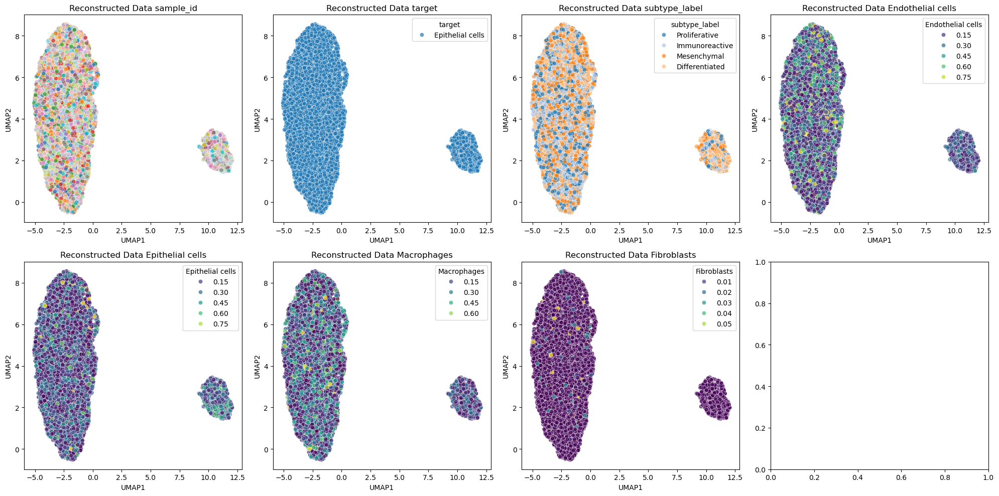

Epithelial cells Silhouette Score (true subtypes):           -0.0213
Epithelial cells Calinski–Harabasz Index (true subtypes):   18.75
Processing model folder: buddi4_0957ddb6;beta=1.0;label_beta=100.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


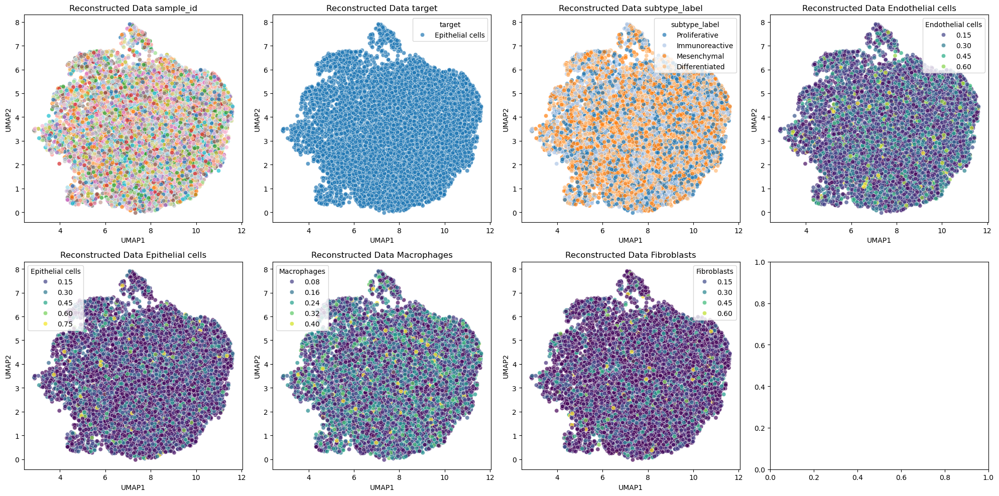

Epithelial cells Silhouette Score (true subtypes):           -0.0047
Epithelial cells Calinski–Harabasz Index (true subtypes):   1.90
Processing model folder: buddi4_0eb47219;beta=10.0;label_beta=100.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


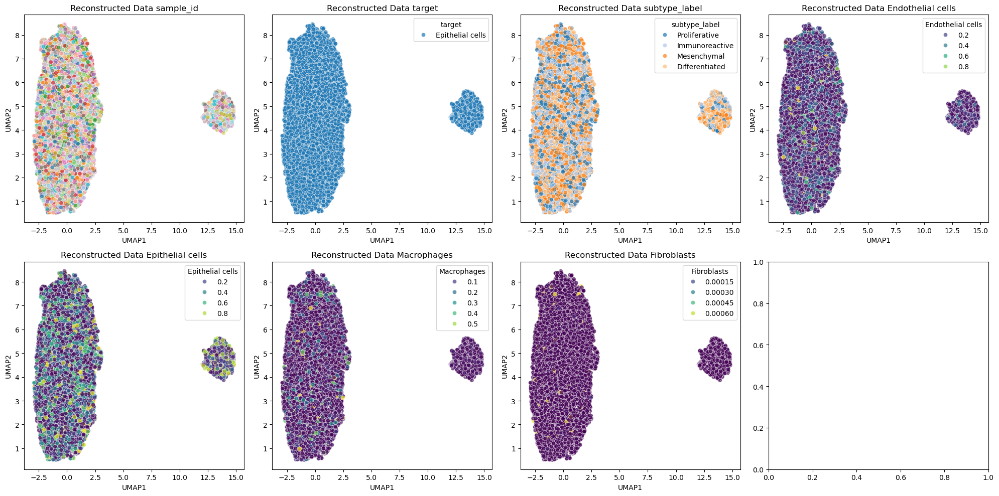

Epithelial cells Silhouette Score (true subtypes):           -0.0227
Epithelial cells Calinski–Harabasz Index (true subtypes):   22.28
Processing model folder: buddi4_1db615ec;beta=1.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


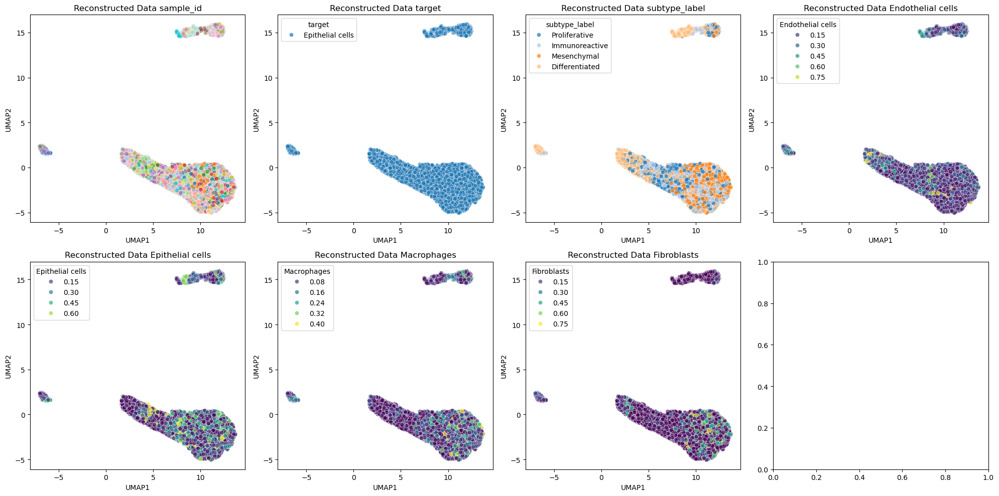

Epithelial cells Silhouette Score (true subtypes):           -0.0281
Epithelial cells Calinski–Harabasz Index (true subtypes):   859.07
Processing model folder: buddi4_20b78de8;beta=100.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


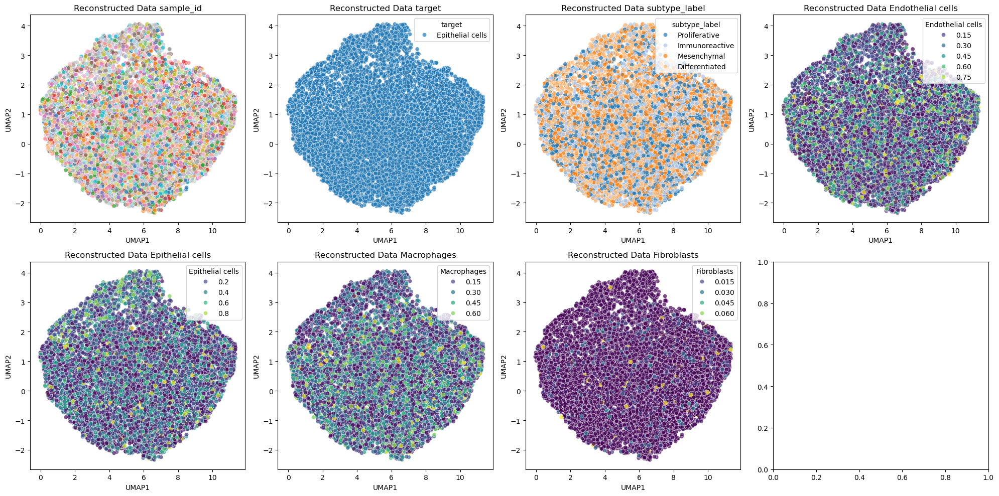

Epithelial cells Silhouette Score (true subtypes):           -0.0112
Epithelial cells Calinski–Harabasz Index (true subtypes):   7.00
Processing model folder: buddi4_245f68d4;beta=1.0;label_beta=10.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


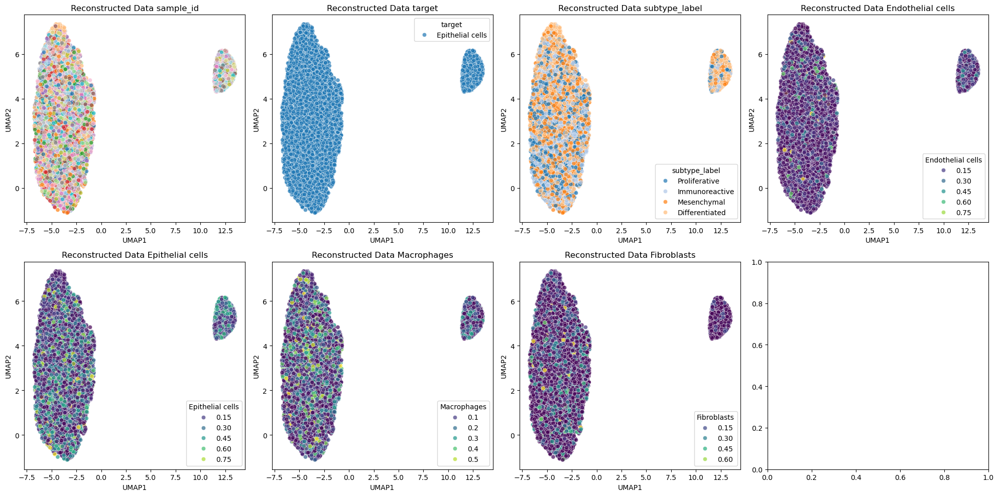

Epithelial cells Silhouette Score (true subtypes):           -0.0237
Epithelial cells Calinski–Harabasz Index (true subtypes):   8.60
Processing model folder: buddi4_30612d56;beta=100.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


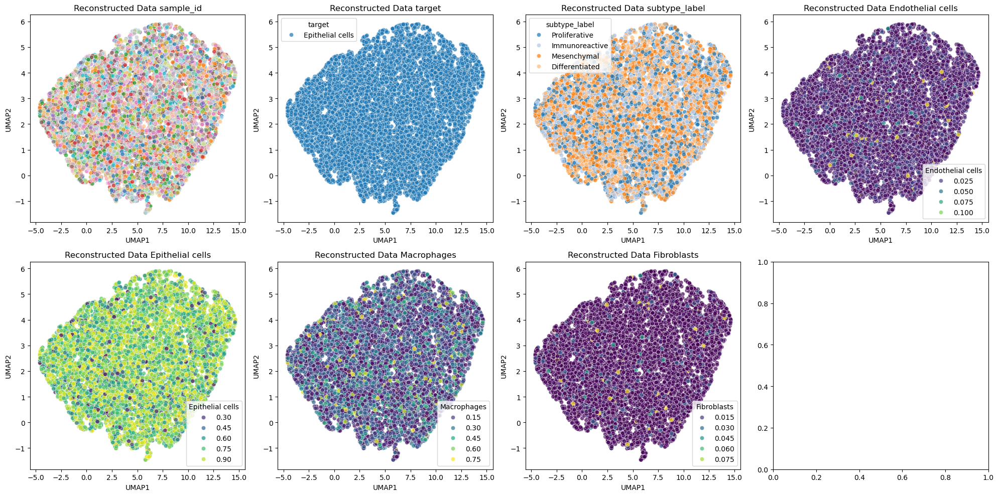

Epithelial cells Silhouette Score (true subtypes):           -0.0065
Epithelial cells Calinski–Harabasz Index (true subtypes):   2.04
Processing model folder: buddi4_3758cfca;beta=10.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.29s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited at iteration 1685 with accuracies 
[3.96303785e-15 5.46296118e-07 1.45778967e-06 1.69503250e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
Use iteration 1685 instead with accuracy 
9.24779573981814e-07.

  _, diffusion_map = lobpcg(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited postprocessing with accuracies 
[3.72002534e-15 5.46296081e-07 1.45778044e-06 1.69504045e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
  _, diffusion_map = lobpcg(


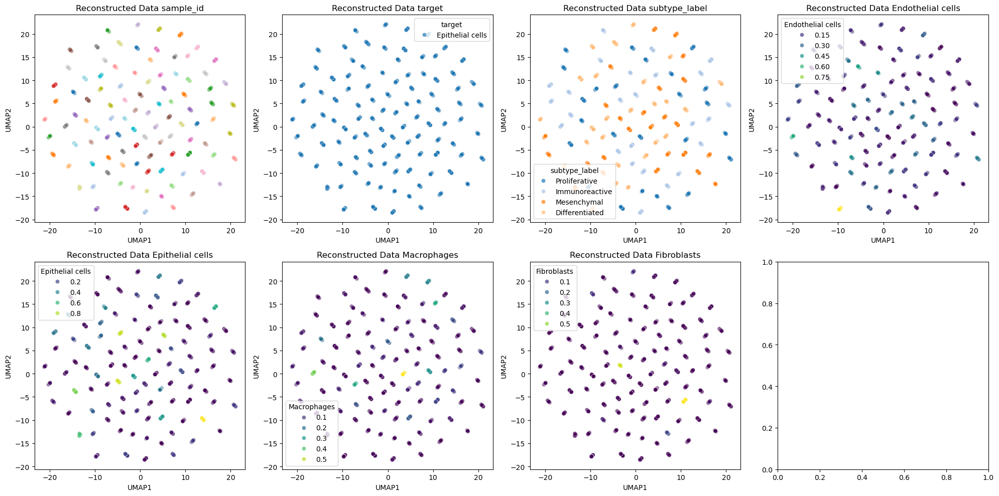

Epithelial cells Silhouette Score (true subtypes):           0.0523
Epithelial cells Calinski–Harabasz Index (true subtypes):   750.71
Processing model folder: buddi4_3a0f7eac;beta=100.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


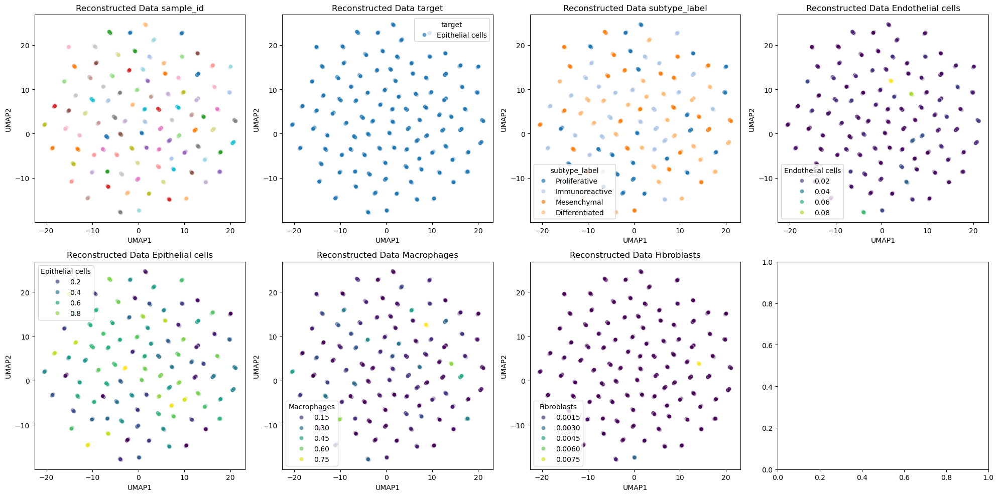

Epithelial cells Silhouette Score (true subtypes):           0.0761
Epithelial cells Calinski–Harabasz Index (true subtypes):   687.95
Processing model folder: buddi4_3b5c2e02;beta=1.0;label_beta=100.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


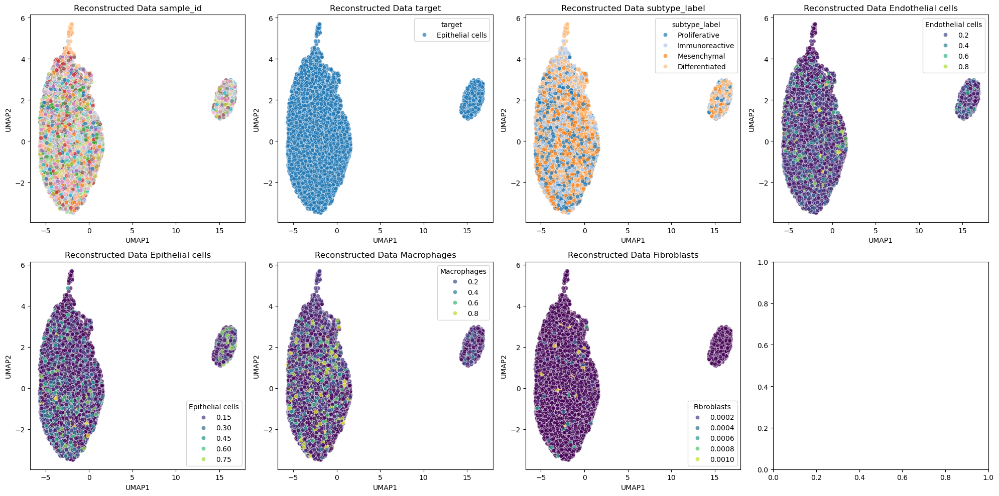

Epithelial cells Silhouette Score (true subtypes):           -0.0334
Epithelial cells Calinski–Harabasz Index (true subtypes):   18.06
Processing model folder: buddi4_4fc4276b;beta=1.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


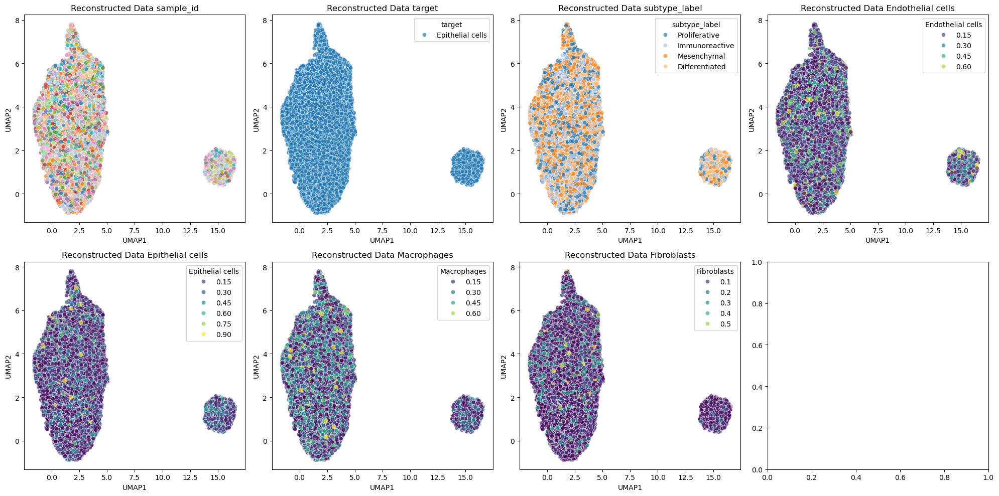

Epithelial cells Silhouette Score (true subtypes):           -0.0168
Epithelial cells Calinski–Harabasz Index (true subtypes):   20.90
Processing model folder: buddi4_5d58db34;beta=10.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


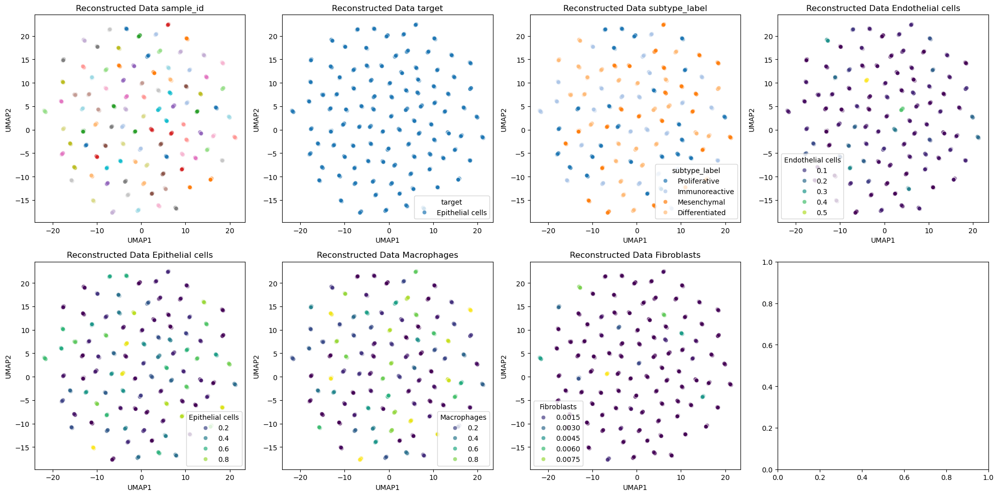

Epithelial cells Silhouette Score (true subtypes):           0.0730
Epithelial cells Calinski–Harabasz Index (true subtypes):   692.70
Processing model folder: buddi4_5d9bd07f;beta=10.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


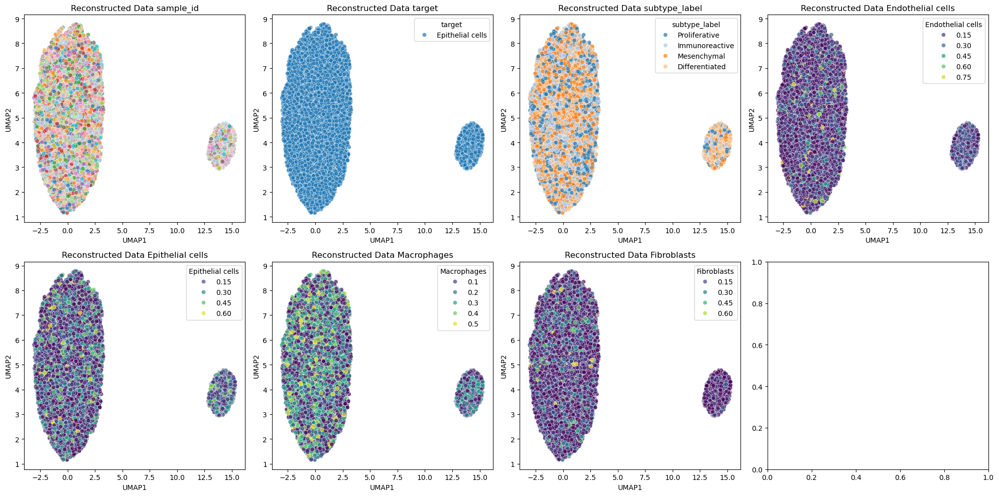

Epithelial cells Silhouette Score (true subtypes):           -0.0173
Epithelial cells Calinski–Harabasz Index (true subtypes):   20.94
Processing model folder: buddi4_5e1235b9;beta=1.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


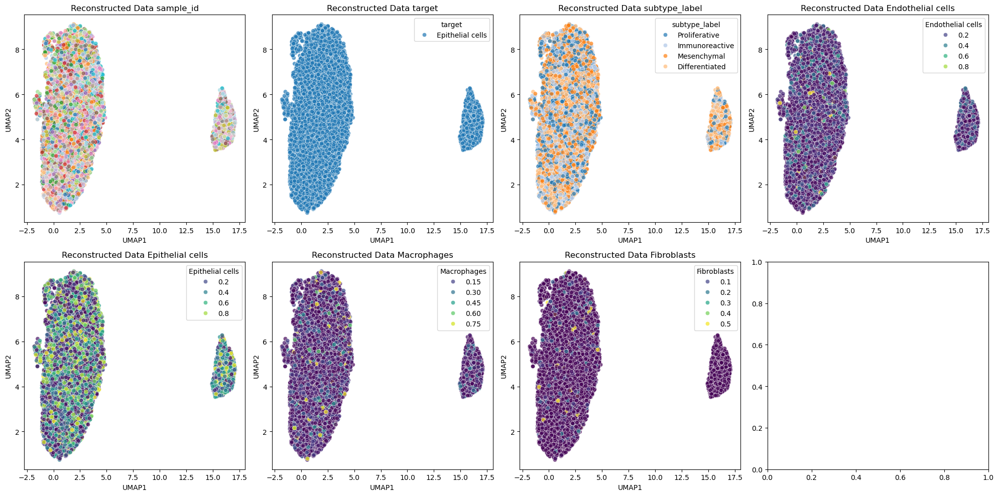

Epithelial cells Silhouette Score (true subtypes):           -0.0248
Epithelial cells Calinski–Harabasz Index (true subtypes):   17.86
Processing model folder: buddi4_5eb8e613;beta=10.0;label_beta=10.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


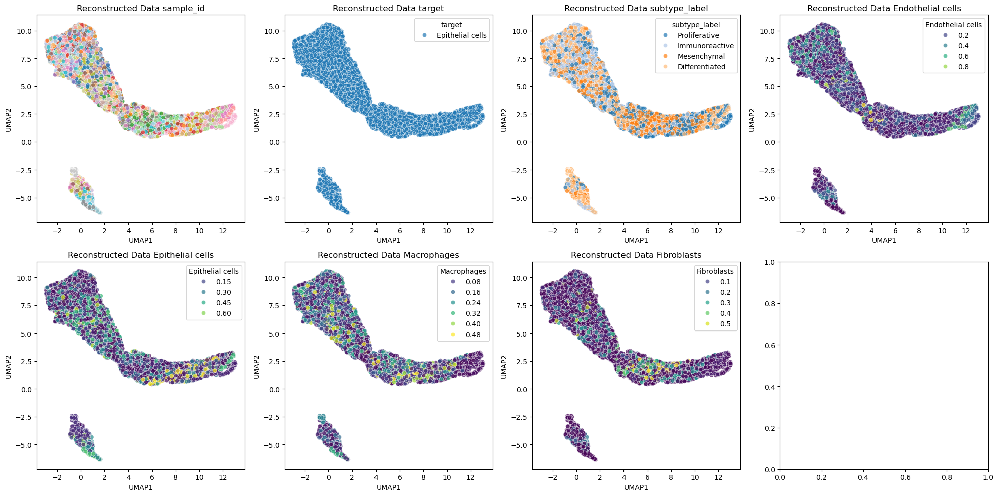

Epithelial cells Silhouette Score (true subtypes):           -0.0605
Epithelial cells Calinski–Harabasz Index (true subtypes):   278.12
Processing model folder: buddi4_6058b1c5;beta=10.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


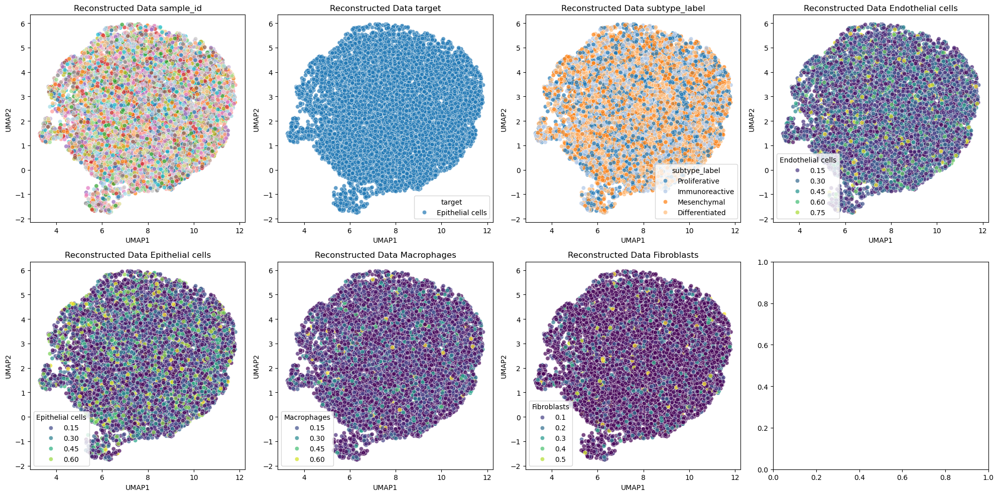

Epithelial cells Silhouette Score (true subtypes):           -0.0033
Epithelial cells Calinski–Harabasz Index (true subtypes):   0.73
Processing model folder: buddi4_7760b8d2;beta=10.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


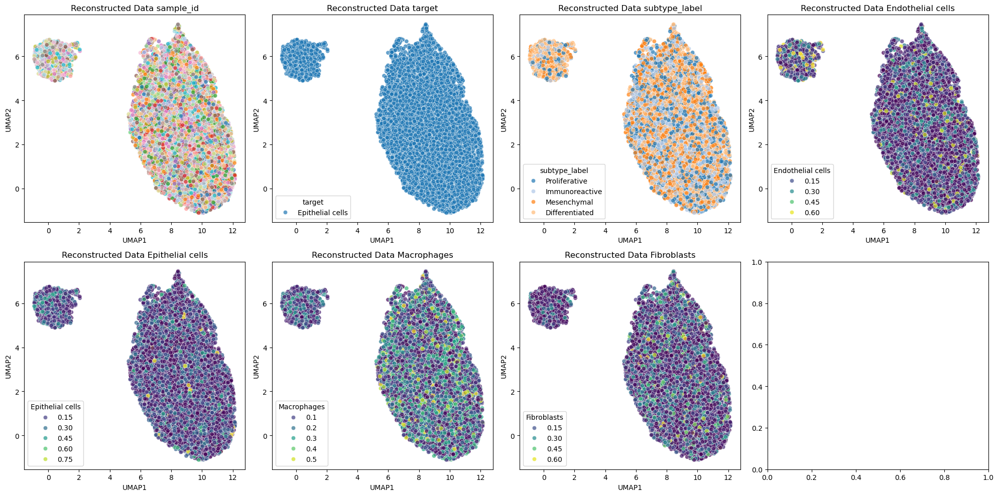

Epithelial cells Silhouette Score (true subtypes):           -0.0140
Epithelial cells Calinski–Harabasz Index (true subtypes):   6.46
Processing model folder: buddi4_804726e7;beta=100.0;label_beta=10.0;slack_beta=1.0
  No training found in /home/weishanli/CU/DavidsonLab/BuddiHGSC/HGSC_buddi_subtype_analysis/trained/buddi4_804726e7;beta=100.0;label_beta=10.0;slack_beta=1.0
Processing model folder: buddi4_8e75922b;beta=100.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited at iteration 2000 with accuracies 
[1.07659375e-13 6.41971653e-07 3.05287954e-06 5.52668840e-05]
not reaching the requested tolerance 1.4901161193847656e-06.
Use iteration 630 instead with accuracy 
5.1694925621498885e-06.

  _, diffusion_map = lobpcg(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited postprocessing with accuracies 
[9.97529329e-15 5.11494807e-06 4.91064237e-06 1.06523796e-05]
not reaching the requested tolerance 1.4901161193847656e-06.
  _, diffusion_map = lobpcg(


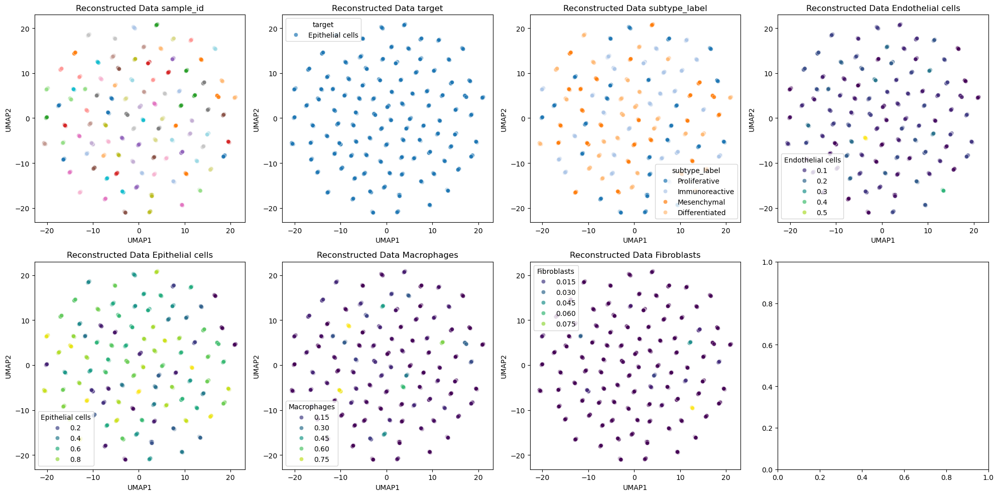

Epithelial cells Silhouette Score (true subtypes):           0.0738
Epithelial cells Calinski–Harabasz Index (true subtypes):   728.79
Processing model folder: buddi4_8f2c83d9;beta=1.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


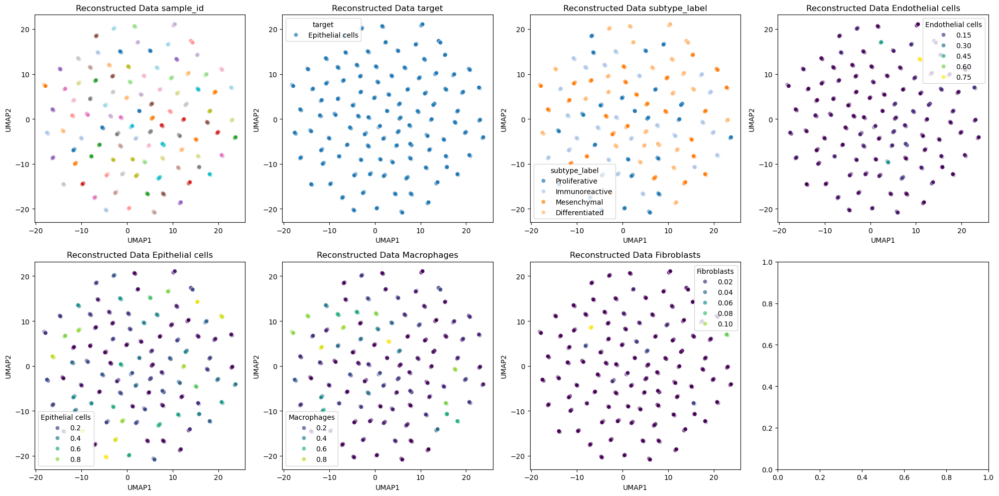

Epithelial cells Silhouette Score (true subtypes):           0.0691
Epithelial cells Calinski–Harabasz Index (true subtypes):   679.59
Processing model folder: buddi4_978119ce;beta=100.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


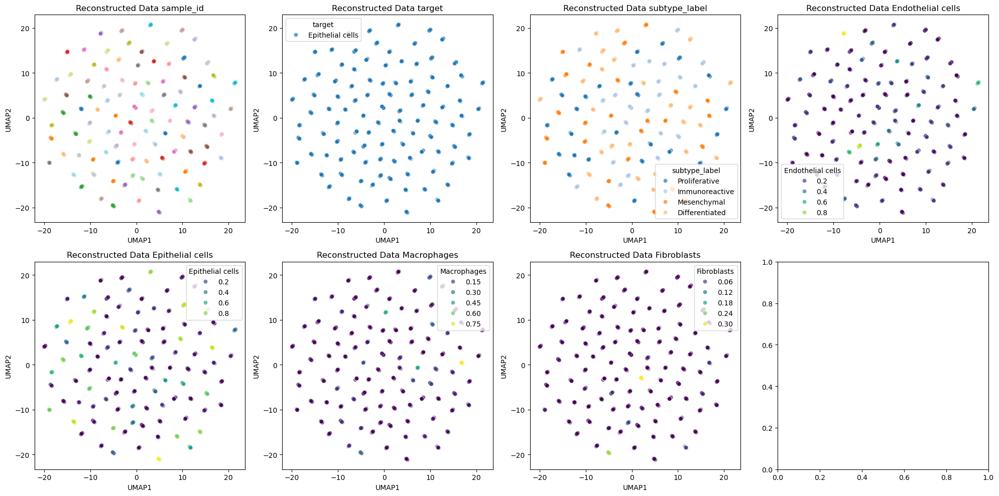

Epithelial cells Silhouette Score (true subtypes):           0.0580
Epithelial cells Calinski–Harabasz Index (true subtypes):   574.42
Processing model folder: buddi4_a08b0de0;beta=10.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited at iteration 2000 with accuracies 
[5.99323636e-15 6.52619571e-07 5.01768553e-06 4.14442030e-05]
not reaching the requested tolerance 1.4901161193847656e-06.
Use iteration 522 instead with accuracy 
1.6004278408343628e-06.

  _, diffusion_map = lobpcg(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited postprocessing with accuracies 
[1.36401042e-15 6.63807969e-07 2.62358564e-06 3.11431777e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
  _, diffusion_map = lobpcg(


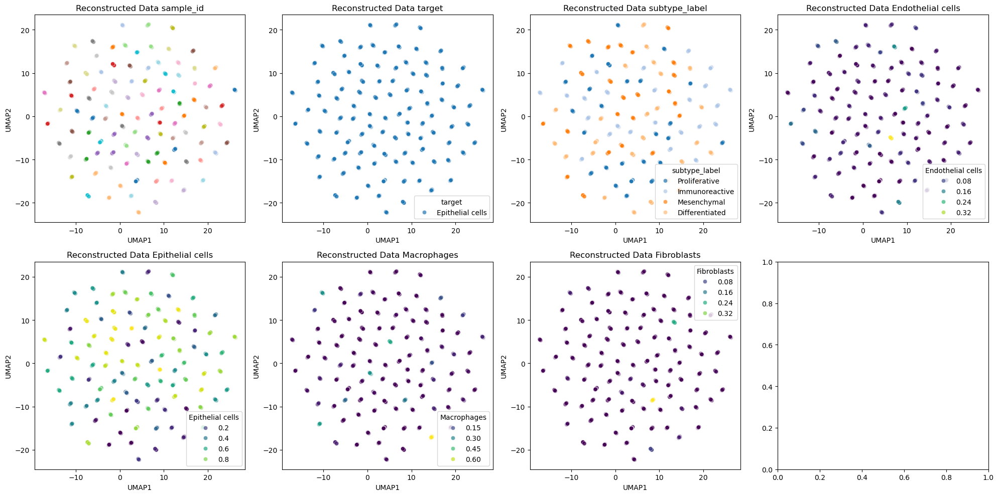

Epithelial cells Silhouette Score (true subtypes):           0.0690
Epithelial cells Calinski–Harabasz Index (true subtypes):   672.63
Processing model folder: buddi4_a5f47abc;beta=10.0;label_beta=10.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


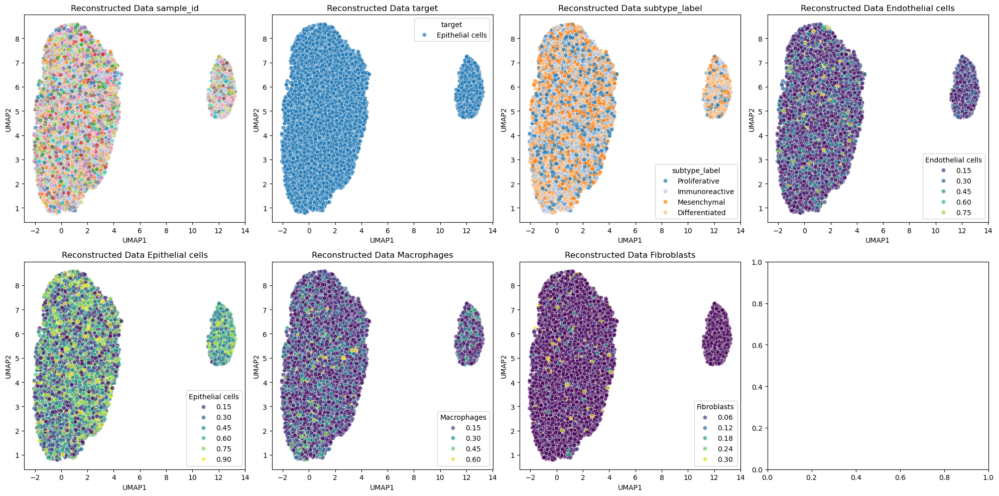

Epithelial cells Silhouette Score (true subtypes):           -0.0247
Epithelial cells Calinski–Harabasz Index (true subtypes):   14.00
Processing model folder: buddi4_ad103b58;beta=1.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


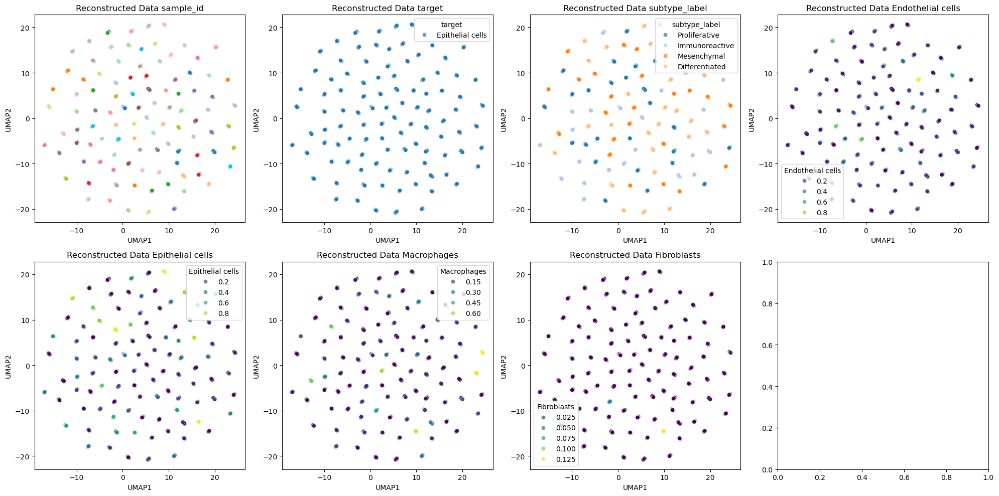

Epithelial cells Silhouette Score (true subtypes):           0.0579
Epithelial cells Calinski–Harabasz Index (true subtypes):   658.22
Processing model folder: buddi4_b02e1758;beta=1.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.30s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


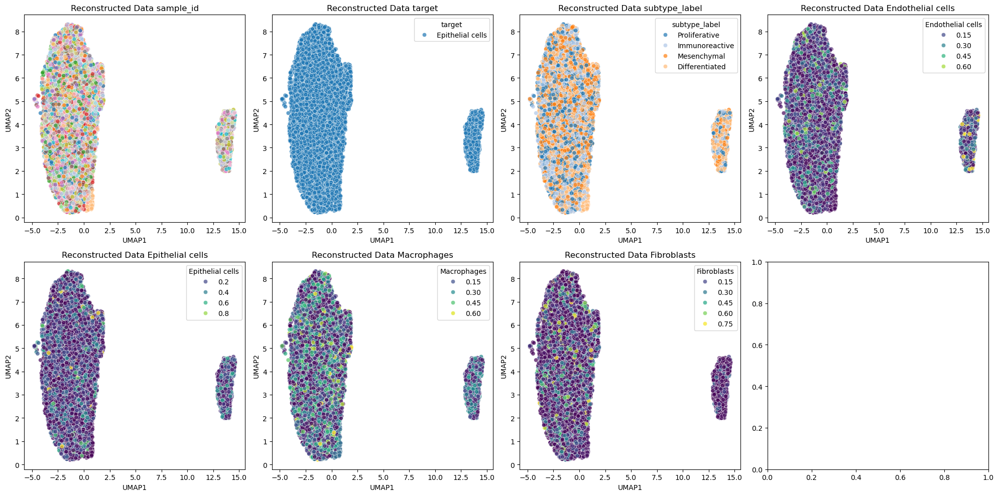

Epithelial cells Silhouette Score (true subtypes):           -0.0241
Epithelial cells Calinski–Harabasz Index (true subtypes):   19.20
Processing model folder: buddi4_b21d49ef;beta=1.0;label_beta=10.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


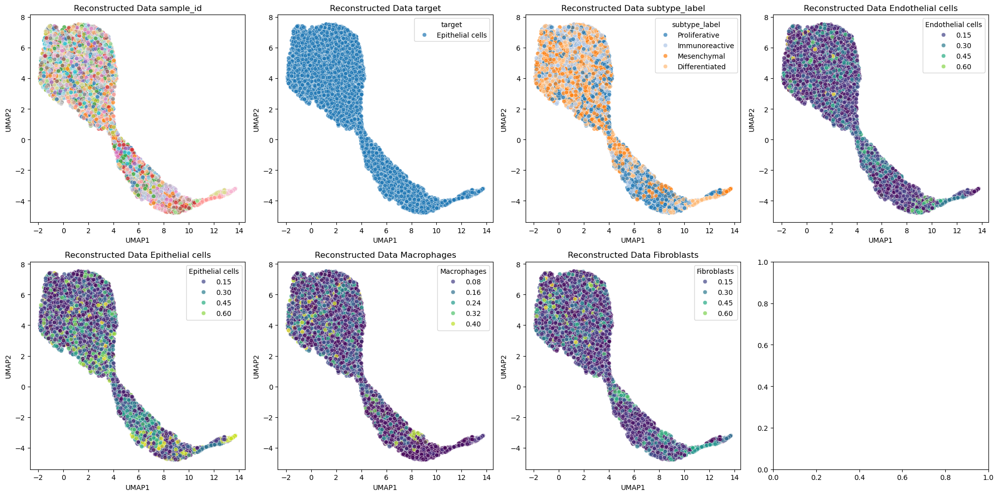

Epithelial cells Silhouette Score (true subtypes):           -0.0694
Epithelial cells Calinski–Harabasz Index (true subtypes):   225.65
Processing model folder: buddi4_b6253b5a;beta=100.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.29s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


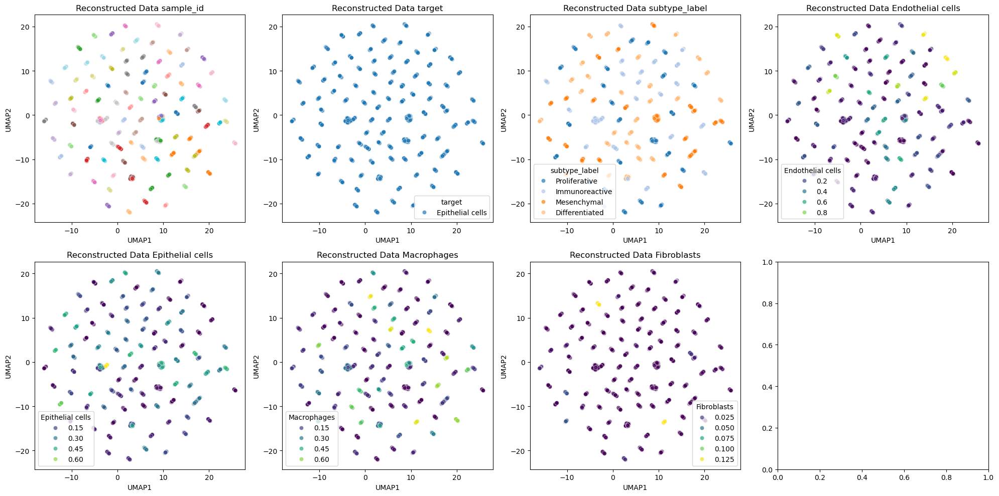

Epithelial cells Silhouette Score (true subtypes):           0.0749
Epithelial cells Calinski–Harabasz Index (true subtypes):   986.49
Processing model folder: buddi4_bc0605eb;beta=1.0;label_beta=1.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.28s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


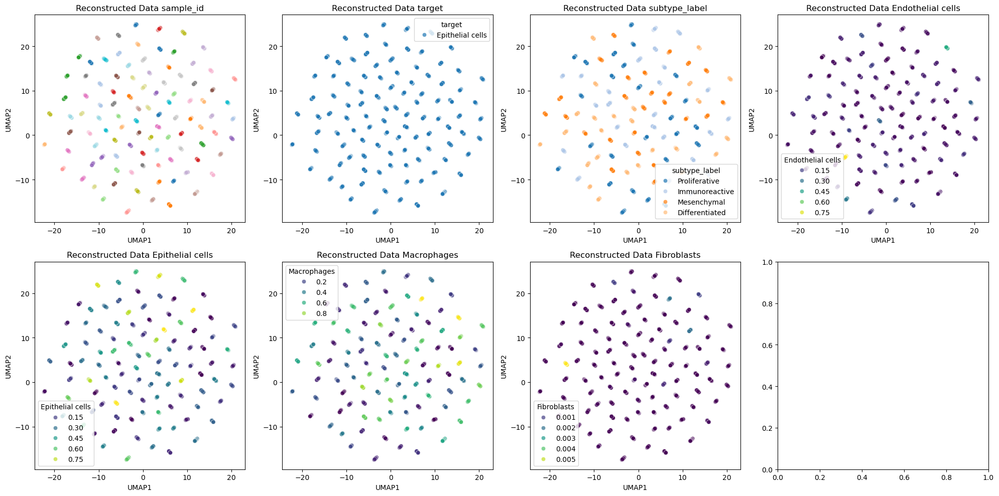

Epithelial cells Silhouette Score (true subtypes):           0.0394
Epithelial cells Calinski–Harabasz Index (true subtypes):   642.52
Processing model folder: buddi4_bc0a9dff;beta=100.0;label_beta=100.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


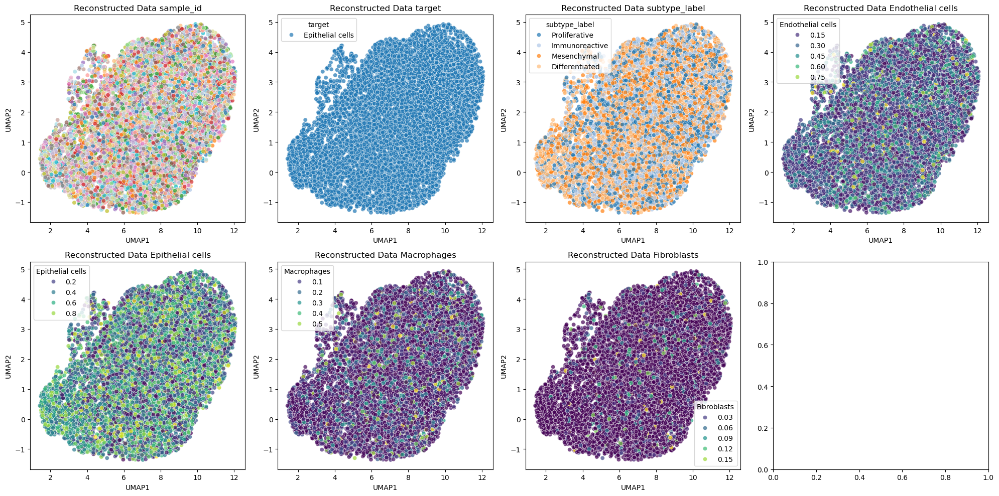

Epithelial cells Silhouette Score (true subtypes):           -0.0151
Epithelial cells Calinski–Harabasz Index (true subtypes):   18.66
Processing model folder: buddi4_dd77cdd8;beta=100.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.26s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


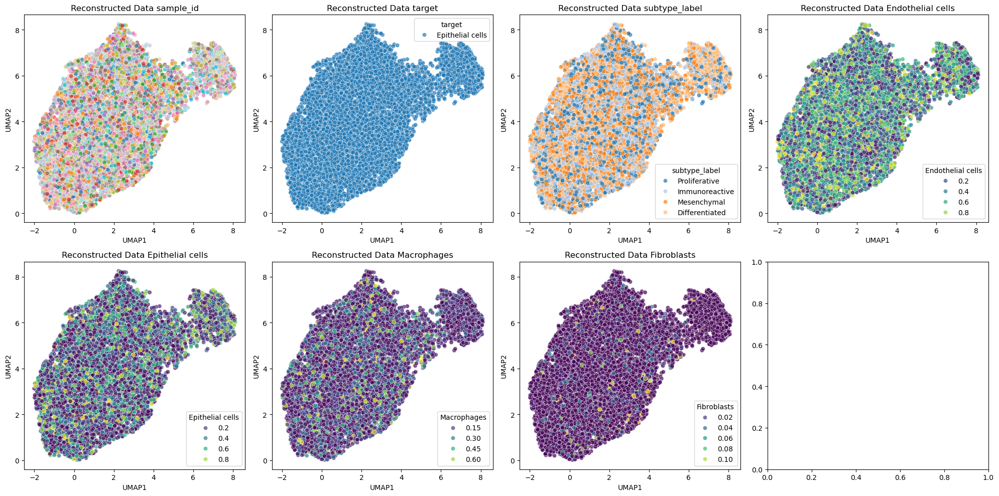

Epithelial cells Silhouette Score (true subtypes):           -0.0183
Epithelial cells Calinski–Harabasz Index (true subtypes):   11.08
Processing model folder: buddi4_e3248280;beta=1.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited at iteration 2000 with accuracies 
[3.29005208e-14 1.39430364e-07 3.29175227e-07 9.37717868e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
Use iteration 1865 instead with accuracy 
6.211725353574137e-07.

  _, diffusion_map = lobpcg(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited postprocessing with accuracies 
[5.38705074e-15 1.40211510e-07 3.17308216e-07 2.02717141e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
  _, diffusion_map = lobpcg(


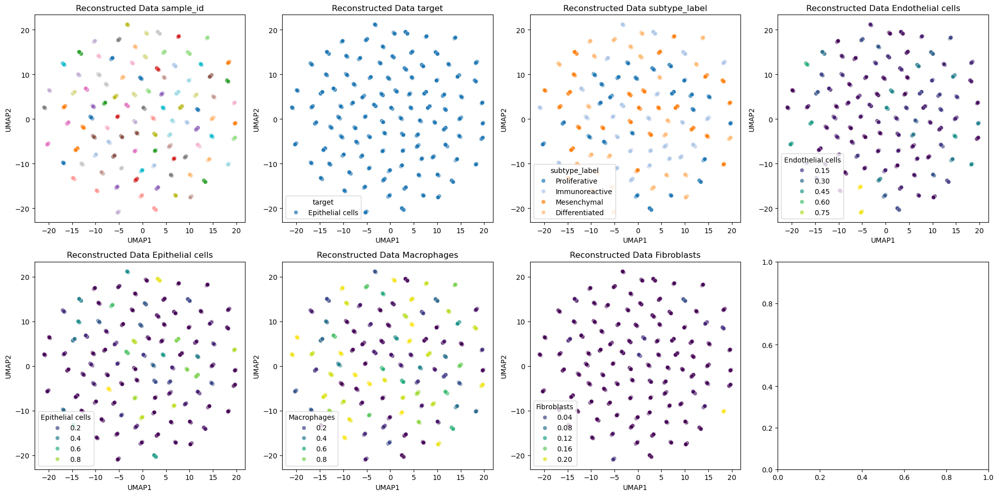

Epithelial cells Silhouette Score (true subtypes):           0.0717
Epithelial cells Calinski–Harabasz Index (true subtypes):   663.40
Processing model folder: buddi4_e4ce5b46;beta=100.0;label_beta=10.0;slack_beta=1.0
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


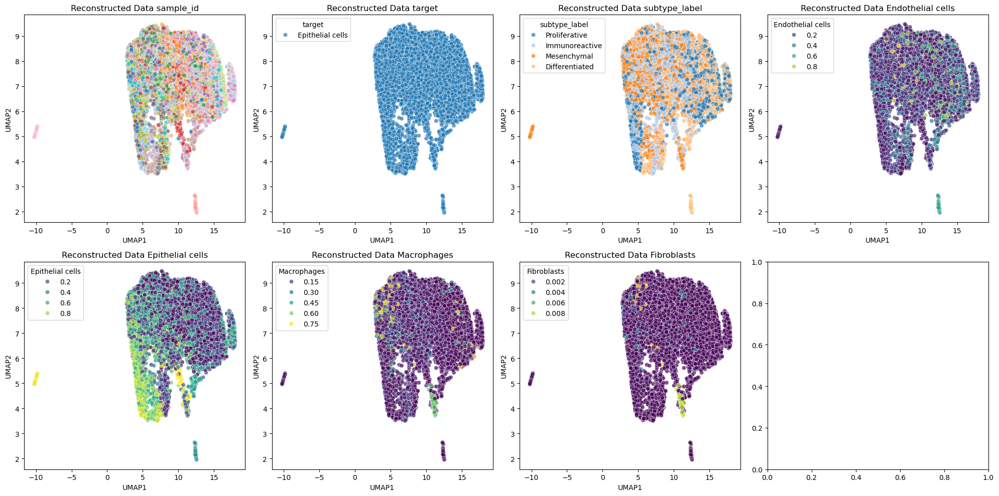

Epithelial cells Silhouette Score (true subtypes):           -0.0535
Epithelial cells Calinski–Harabasz Index (true subtypes):   348.53
Processing model folder: buddi4_e6bc090b;beta=10.0;label_beta=10.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.24s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


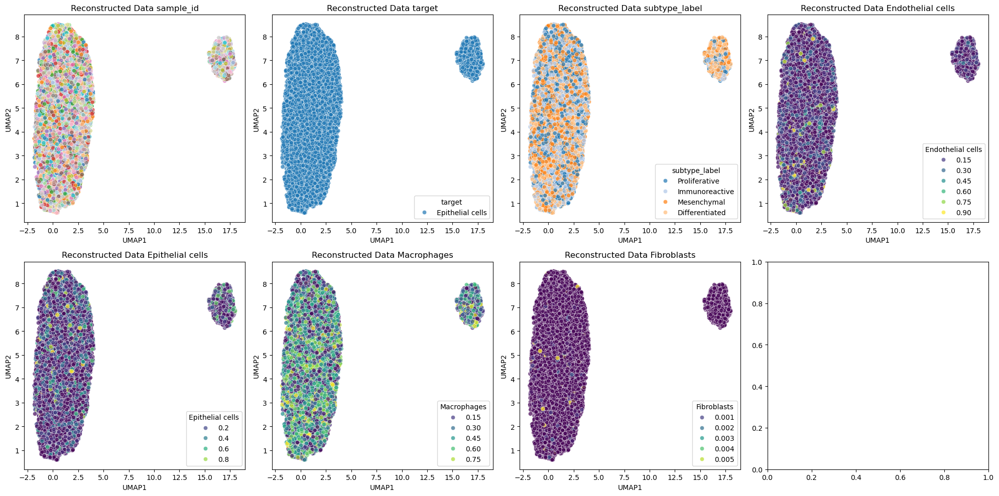

Epithelial cells Silhouette Score (true subtypes):           -0.0252
Epithelial cells Calinski–Harabasz Index (true subtypes):   20.76
Processing model folder: buddi4_f1e9cdf7;beta=100.0;label_beta=100.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


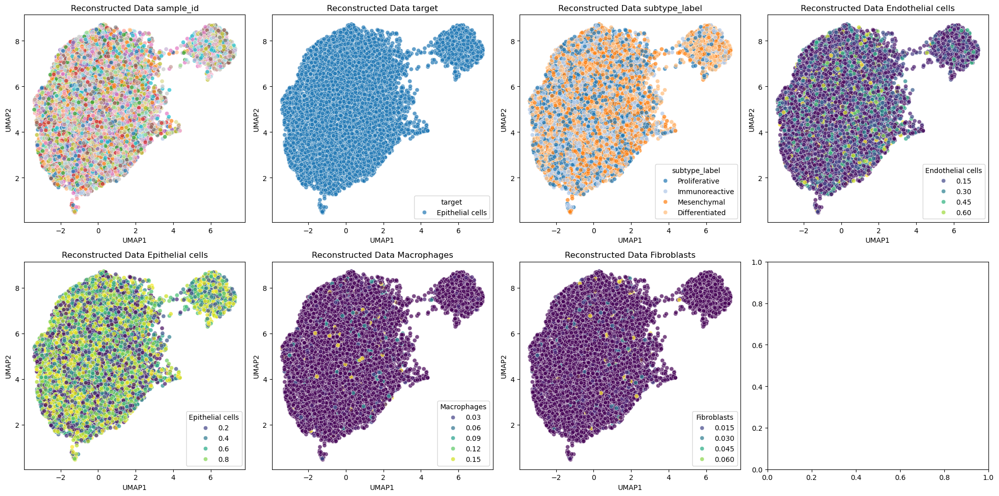

Epithelial cells Silhouette Score (true subtypes):           -0.0279
Epithelial cells Calinski–Harabasz Index (true subtypes):   23.94
Processing model folder: buddi4_fa9bbf43;beta=10.0;label_beta=1.0;slack_beta=0.1
  Running imputation...


Imputing single cell types: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]


    Plotting UMAP for cell type Epithelial cells...


/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited at iteration 2000 with accuracies 
[7.45159572e-14 2.68008096e-07 1.96512294e-06 2.08897263e-05]
not reaching the requested tolerance 1.4901161193847656e-06.
Use iteration 1858 instead with accuracy 
7.398612378575594e-07.

  _, diffusion_map = lobpcg(
/home/weishanli/anaconda3/envs/buddi_conda/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:455: UserWarning: Exited postprocessing with accuracies 
[6.46340509e-15 1.93451226e-07 5.38399873e-07 2.22759515e-06]
not reaching the requested tolerance 1.4901161193847656e-06.
  _, diffusion_map = lobpcg(


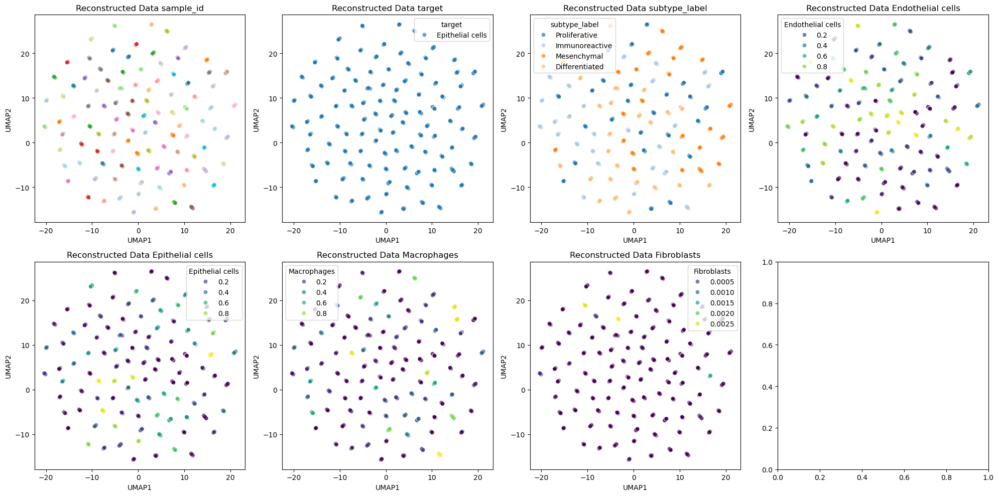

Epithelial cells Silhouette Score (true subtypes):           0.0636
Epithelial cells Calinski–Harabasz Index (true subtypes):   667.26


In [16]:
import warnings
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for model_folder in model_folders:
        print(f"Processing model folder: {model_folder.parts[-1]}")

        if not (model_folder / 'train_loss.csv').exists():
            print(f"  No training found in {model_folder}")
            continue

        process_model_folder(
            model_folder=model_folder,
            query_kwargs={
                'sample_id': selected_sample_ids,
            },
            select_ct = [
                'Epithelial cells',
                # 'Macrophages'
            ],
            ct_prop_to_plot = [
                'Endothelial cells',
                'Epithelial cells',
                'Macrophages',
                'Fibroblasts',
            ],
            name_prefix=f'impute_balanced_n={n}_'
        )

## Visualize External Validation Metrics

### Collect metrics across model hyper-parameters

In [18]:
records = []
for model_folder in model_folders:
    folder_name = model_folder.name
    print(f"Processing model folder: {folder_name}")

    # 1. Read the JSON metrics
    metrics_path = model_folder / "Epithelial cells_metrics.json"
    if metrics_path.exists():
        with open(metrics_path, "r") as jf:
            metrics = json.load(jf)
    else:
        metrics = {}
        print(f"  ↳ Warning: {metrics_path.name} not found")

    # 2. Read the YAML loss config
    yaml_path = model_folder / "loss_config.yaml"
    if yaml_path.exists():
        with open(yaml_path, "r") as yf:
            # assume single‐level key:value pairs
            loss_cfg = yaml.safe_load(yf)
    else:
        loss_cfg = {}
        print(f"  ↳ Warning: {yaml_path.name} not found")

    # 3. Combine into one flat record
    record = {"model_folder": folder_name}
    record.update(metrics)    # e.g. silhouette_score, calinski_harabasz_score
    record.update(loss_cfg)   # e.g. learning_rate, beta, etc.
    records.append(record)

Processing model folder: buddi4_063868e8;beta=10.0;label_beta=100.0;slack_beta=1.0
Processing model folder: buddi4_0957ddb6;beta=1.0;label_beta=100.0;slack_beta=1.0
Processing model folder: buddi4_0eb47219;beta=10.0;label_beta=100.0;slack_beta=1.0
Processing model folder: buddi4_1db615ec;beta=1.0;label_beta=10.0;slack_beta=0.1
Processing model folder: buddi4_20b78de8;beta=100.0;label_beta=10.0;slack_beta=0.1
Processing model folder: buddi4_245f68d4;beta=1.0;label_beta=10.0;slack_beta=1.0
Processing model folder: buddi4_30612d56;beta=100.0;label_beta=100.0;slack_beta=0.1
Processing model folder: buddi4_3758cfca;beta=10.0;label_beta=1.0;slack_beta=1.0
Processing model folder: buddi4_3a0f7eac;beta=100.0;label_beta=1.0;slack_beta=0.1
Processing model folder: buddi4_3b5c2e02;beta=1.0;label_beta=100.0;slack_beta=1.0
Processing model folder: buddi4_4fc4276b;beta=1.0;label_beta=100.0;slack_beta=0.1
Processing model folder: buddi4_5d58db34;beta=10.0;label_beta=1.0;slack_beta=1.0
Processing mode

In [19]:
parsed_records = []
for record in records:
    parsed_record = {}
    for k, v in record.items():
        if isinstance(v, dict):
            parsed_record[k] = v['loss_weight']
        else:
            parsed_record[k] = v
    parsed_records.append(parsed_record)
metric_df =pd.DataFrame(parsed_records)
metric_df.head()

,model_folder,silhouette_score,calinski_harabasz_score,x_hat_sup,x_hat_unsup,kl_label,kl_stim,kl_samp_type,kl_slack,label_pred,stim_pred,samp_type_pred,y_hat,y_dummy
0,buddi4_063868e8;beta=10.0;label_beta=100.0;sla...,-0.021257,18.753284,10.0,10.0,100.0,10.0,10.0,1.0,100.0,100.0,100.0,100.0,0.0
1,buddi4_0957ddb6;beta=1.0;label_beta=100.0;slac...,-0.004714,1.899925,10.0,10.0,100.0,1.0,1.0,1.0,100.0,100.0,100.0,100.0,0.0
2,buddi4_0eb47219;beta=10.0;label_beta=100.0;sla...,-0.022687,22.281960,1.0,1.0,100.0,10.0,10.0,1.0,100.0,100.0,100.0,100.0,0.0
3,buddi4_1db615ec;beta=1.0;label_beta=10.0;slack...,-0.028061,859.073669,1.0,1.0,10.0,1.0,1.0,0.1,100.0,100.0,100.0,100.0,0.0
4,buddi4_20b78de8;beta=100.0;label_beta=10.0;sla...,-0.011178,7.002595,10.0,10.0,10.0,100.0,100.0,0.1,100.0,100.0,100.0,100.0,0.0


In [20]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

def plot_heatmap_grid(
    df,
    param1: str,
    param2: str,
    param3: str,
    param4: str,
    metric_col: str = 'calinski_harabasz_score',
    aggfunc='mean',
    cmap='viridis',
    figsize=None,
    panel_width=3,
):
    """
    Plots a grid of heatmaps of `metric_col` pivoted by (param1 × param2),
    with rows=factor(param3) and cols=factor(param4), all sharing the same color scale.
    """
    # unique levels
    levels3 = sorted(df[param3].unique())
    levels4 = sorted(df[param4].unique())
    nrow, ncol = len(levels3), len(levels4)

    # figure size default: 4"x5" per subplot
    if figsize is None:
        figsize = (panel_width * ncol, panel_width * nrow)
    fig, axes = plt.subplots(nrow, ncol, figsize=figsize, sharex='col', sharey='row')

    # flatten axes array for easy cbar placement
    axes_arr = np.array(axes).reshape(-1)

    # global vmin/vmax for all heatmaps
    vmin = df[metric_col].min()
    vmax = df[metric_col].max()

    for i, lvl3 in enumerate(levels3):
        for j, lvl4 in enumerate(levels4):
            # pick correct Axes
            ax = axes[i, j] if nrow > 1 and ncol > 1 else (
                 axes[i] if ncol == 1 else axes[j])

            sub = df[(df[param3] == lvl3) & (df[param4] == lvl4)]
            pivot_df = sub.pivot_table(
                index=param1,
                columns=param2,
                values=metric_col,
                aggfunc=aggfunc
            )

            sns.heatmap(
                pivot_df,
                annot=True,
                fmt=".1f",
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
                cbar=(ax is axes_arr[-1]),
                cbar_kws={'label': metric_col},
                ax=ax
            )

            ax.set_title(f"{param3} = {lvl3}\n{param4} = {lvl4}")
            if i == nrow - 1:
                ax.set_xlabel(param2)
            else:
                ax.set_xlabel('')

            if j == 0:
                ax.set_ylabel(param1)
            else:
                ax.set_ylabel('')

    plt.tight_layout()
    plt.show()


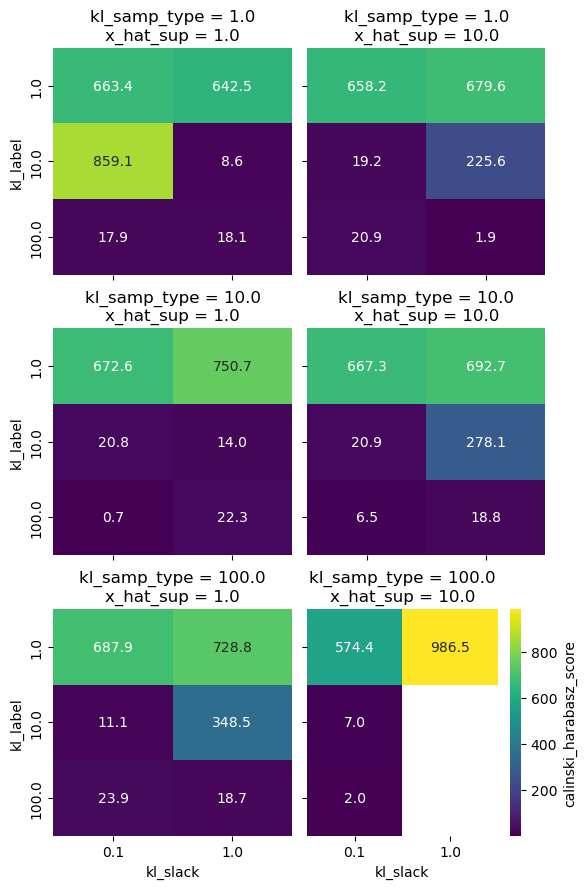

In [21]:
plot_heatmap_grid(
    df=metric_df,
    param1='kl_label',
    param2='kl_slack',
    param3='kl_samp_type',
    param4='x_hat_sup',
    metric_col='calinski_harabasz_score',
    aggfunc='mean'
)